# 密度プロット

## 概要

**密度プロット（Density Plot）** とは，主に量的変数に対して，分布の形状をカーネル密度推定による **曲線** で表現するグラフです．
[ヒストグラム](https://kakeami.github.io/viz-madb/charts4dists/hist.html)より滑らかに分布を表現することが可能ですが，あくまでも推定結果であることに注意が必要です．

![](../figs/charts/density.png)

例えば上図は，作品ごとの掲載位置の分布（の推定値）を表現した密度プロットです．ヒストグラムと異なり，複数の分布を重ねて表示できることがわかります．

## Plotlyによる作図方法

Plotlyでは，`plotly.figure_factory.create_distplot()`で密度プロットを作成可能です．

```python
import plotly.figure_factory as ff
fig = ff.create_distplot(
    [hist_data, labels, show_hist=False)
```

ただし，`hist_data`は描画したい変数ごとの変数のリスト，`labels`は凡例名のリストを表します．`hist_data`の要素数と，`labels`の要素数は一致している必要があるのでご注意ください．

:::{admonition} `show_hist=False`
`plotly.figure_factory.create_distplot()`はデフォルト設定でヒストグラムとDensity plotの両方を作図します．Density plotのみ表示したい場合は，`show_hist=False`を指定しましょう．
:::

## MADB Labを用いた作図例

### 下準備

In [1]:
import pandas as pd
import plotly.figure_factory as ff
import plotly.express as px

import warnings
warnings.filterwarnings('ignore')

In [2]:
# 前処理の結果，以下に分析対象ファイルが格納されていることを想定
PATH_DATA = '../../data/preprocess/out/episodes.csv'
# Jupyter Book用のPlotlyのrenderer
RENDERER = 'plotly_mimetype+notebook'

In [3]:
# 平均掲載位置を算出する際の最小連載数
MIN_WEEKS = 5

In [4]:
def show_fig(fig):
    """Jupyter Bookでも表示可能なようRendererを指定"""
    fig.update_layout(margin=dict(t=50, l=25, r=25, b=25))
    fig.update_layout(legend={
        'yanchor': 'top',
        'xanchor': 'right',
        'x': 0.99, 'y': 0.99})
    fig.show(renderer=RENDERER)

In [5]:
df = pd.read_csv(PATH_DATA)

### 長期連載作品の掲載位置の分布

合計連載週数が多い10作品に対して，同様に分布を図示してみましょう．

In [8]:
df_tmp = \
    df.groupby('cname')['pageStartPosition']\
    .agg(['count', 'mean']).reset_index()
df_tmp = \
    df_tmp.sort_values('count', ascending=False, ignore_index=True)\
    .head(10)
cname2position = df_tmp.groupby('cname')['mean'].first().to_dict()

In [9]:
df_plot = df[df['cname'].isin(list(cname2position.keys()))]\
    .reset_index(drop=True)
df_plot['position'] = df_plot['cname'].apply(
    lambda x: cname2position[x])
df_plot = df_plot.sort_values('position', ignore_index=True)

In [13]:
cnames = df_tmp.sort_values('mean')['cname'].values
data = [
    df[df['cname']==cname].reset_index(drop=True)\
    ['pageStartPosition'] for cname in cnames]

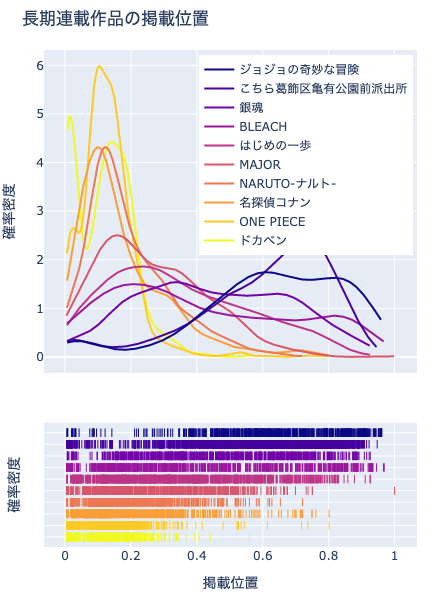

In [15]:
fig = ff.create_distplot(
    data, cnames, show_hist=False,
    colors= px.colors.sequential.Plasma_r)
fig.update_xaxes(title='掲載位置')
fig.update_yaxes(title='確率密度')
fig.update_layout(
    hovermode='x unified', height=600,
    title_text='長期連載作品の掲載位置')
show_fig(fig)

ヒストグラムと異なり，複数の凡例を同時に表示できるため，比較が楽です．

### 長期連載作品の話数毎の掲載位置の分布

In [16]:
# 話数の区切り
UNIT_EP = 200

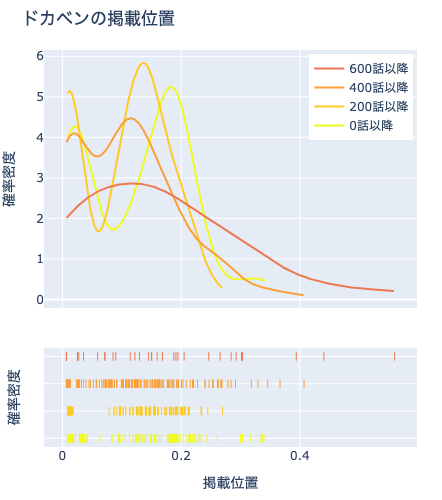

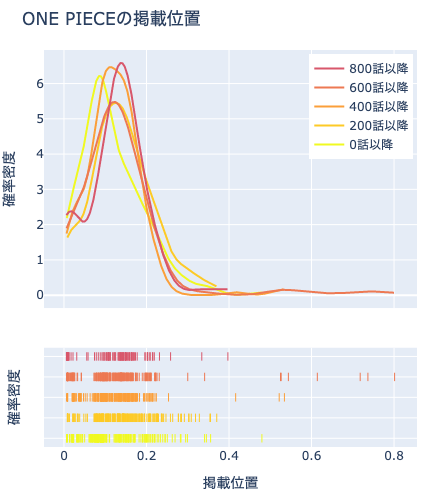

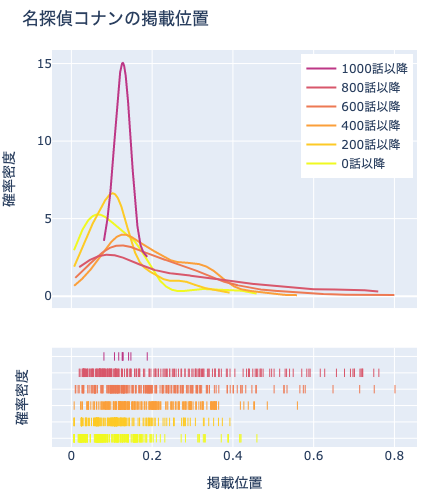

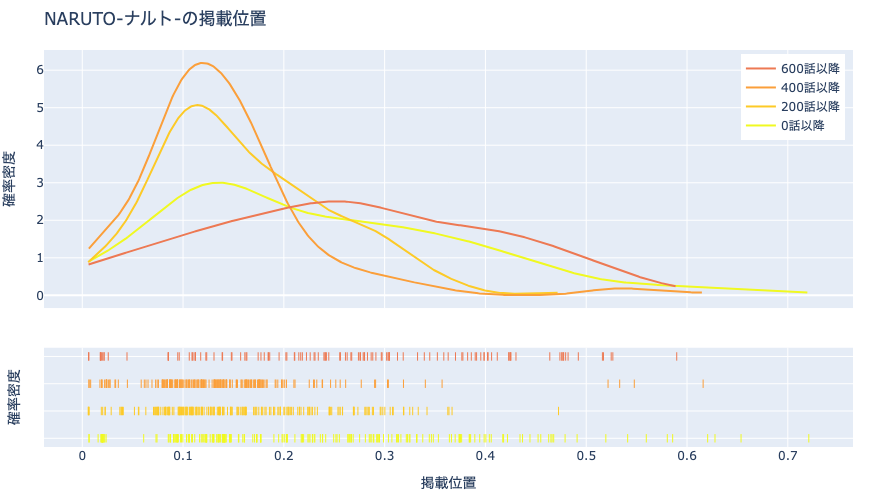

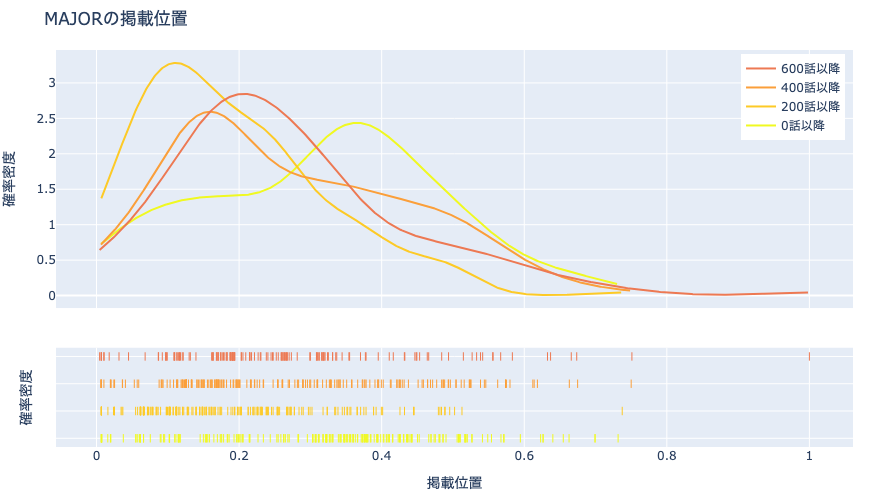

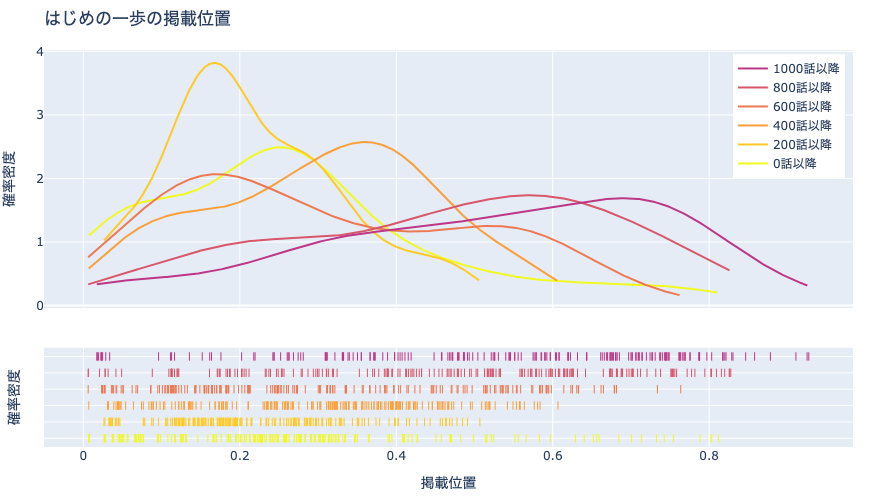

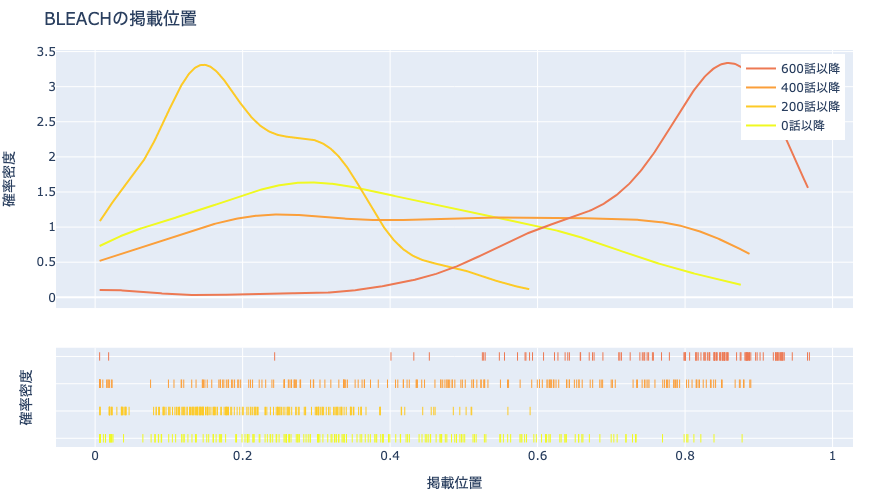

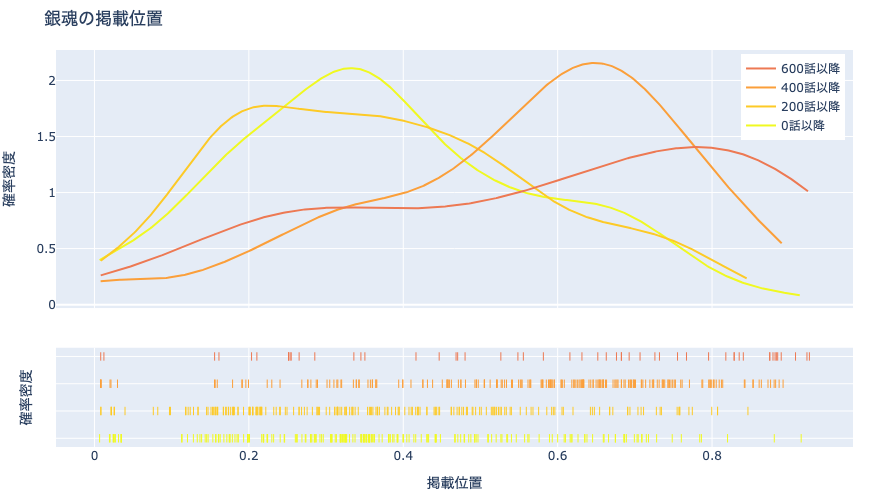

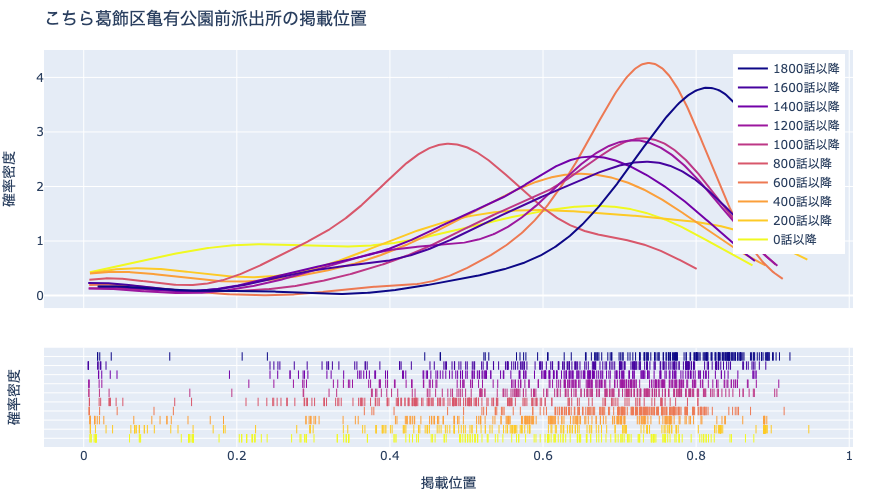

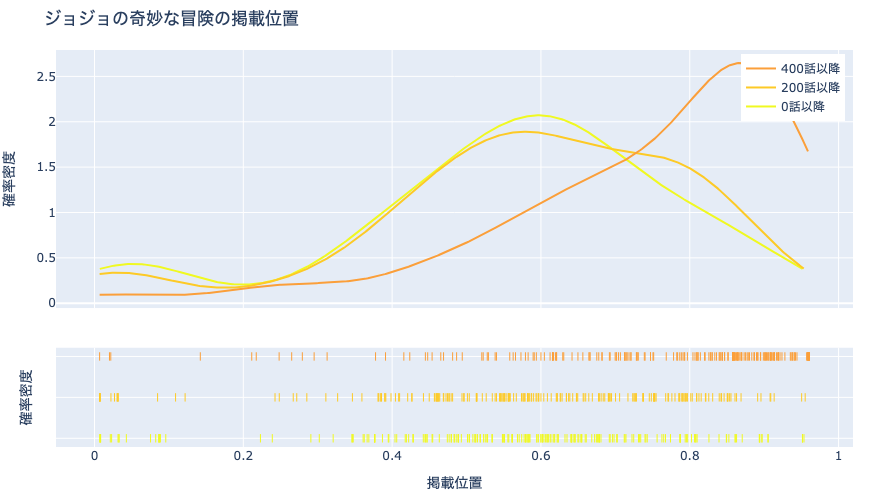

In [17]:
cnames = df_tmp.sort_values('mean')['cname'].values
for cname in cnames:
    df_c = df[df['cname']==cname].reset_index(drop=True)
    df_c['eprange'] = (df_c.index + 1) // UNIT_EP * UNIT_EP
    eps = sorted(df_c['eprange'].unique())
    data = [
        df_c[df_c['eprange']==e]['pageStartPosition']
        for e in eps]
    labels = [f'{e}話以降' for e in eps]
    fig = ff.create_distplot(
        data, labels, show_hist=False,
        colors= px.colors.sequential.Plasma_r)
    fig.update_xaxes(title='掲載位置')
    fig.update_yaxes(title='確率密度')
    fig.update_layout(
        hovermode='x unified', height=500,
        title_text=f'{cname}の掲載位置')
    show_fig(fig)

積み上げヒストグラムを用いた場合より，話数による掲載位置の推移がわかりやすくなりました．